# Setup


In [ ]:
# Run this cell for google colab otherwise setup using GIMP-ML/install.bat
# In Colab, choose runtime with GPU acceleration
!pip install torch==1.8.1+cu111 torchvision==0.9.1+cu111 -f https://download.pytorch.org/whl/lts/1.8/torch_lts.html
!git clone https://github.com/kritiksoman/GIMP-ML.git
%cd GIMP-ML
!git checkout --track origin/GIMP3-ML
%cd ..
!pip install GIMP-ML/.
import gimpml
gimpml.setup_python_weights()
%cd /content/GIMP-ML/testscases

# Imports

In [1]:
import cv2
import gimpml
import matplotlib.pyplot as plt
import numpy as np
import os
import torch

def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename))[:, :, ::-1]
        if img is not None:
            images.append(img)
    return images

image = cv2.imread('sampleinput/img.png')[:,:,::-1]
haze = cv2.imread('sampleinput/haze.png')[:,:,::-1]
alpha = cv2.imread('sampleinput/alpha.png')
face = cv2.imread('sampleinput/portrait.jpg')[:,:,::-1]
mask1 = cv2.imread('sampleinput/im1.png')[:,:,::-1]
mask2 = cv2.imread('sampleinput/im2.png')[:,:,::-1]
inpaint = cv2.imread(r'sampleinput/examples/psv/images/psv_04.png')[:,:,::-1]
inpaint_mask = cv2.imread(r'sampleinput/examples/psv/masks/psv_04.png')[:,:,0]
chocolates = cv2.imread('sampleinput/chocolates.jpg')[:,:,::-1]
blur = cv2.imread('sampleinput/blur.jpg')[:,:,::-1]
seg = cv2.imread('sampleinput/car.jpg')[:,:,::-1]

# K Means

True

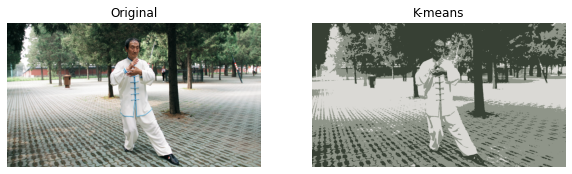

In [2]:
out = gimpml.kmeans(image)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(image)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("K-means")

cv2.imwrite('output/tmp-kmeans.jpg', out[:, :, ::-1])

# De-blurring

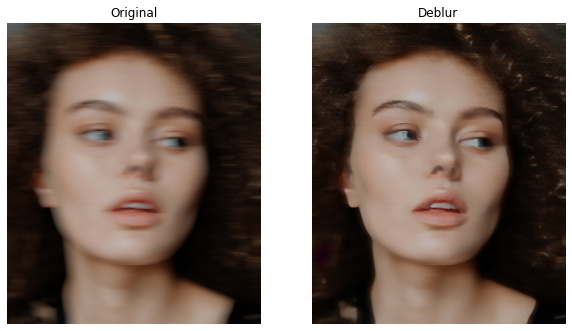

In [6]:
# motion blur removal
out = gimpml.deblur(blur)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(blur)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Deblur")

cv2.imwrite('output/tmp-deblur.jpg', out[:, :, ::-1])
torch.cuda.empty_cache()

# Coloring

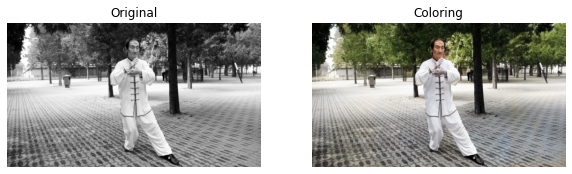

In [8]:
grey_image = image[:, :, 0]
out = gimpml.deepcolor(grey_image)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(np.repeat(grey_image[:, :, np.newaxis], 3, axis=2))
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Coloring")

cv2.imwrite('output/tmp-deepcolor.jpg', out[:, :, ::-1])
torch.cuda.empty_cache()

# De-hazing

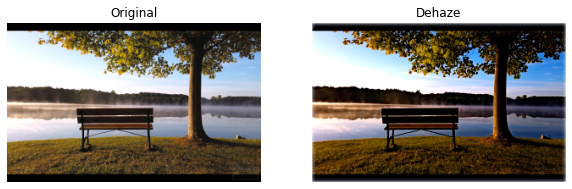

In [9]:
out = gimpml.dehaze(haze)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(haze)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Dehaze")

cv2.imwrite('output/tmp-dehaze.jpg', out[:, :, ::-1])
torch.cuda.empty_cache()

# De-noising

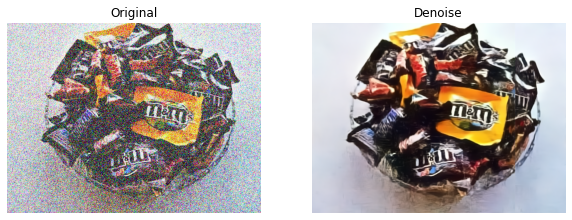

In [10]:
# RGB noise
out = gimpml.denoise(chocolates)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(chocolates)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out.astype(np.uint8))
plt.axis('off')
plt.title("Denoise")

cv2.imwrite('output/tmp-denoise.jpg', out[:, :, ::-1])
torch.cuda.empty_cache()

# Matting

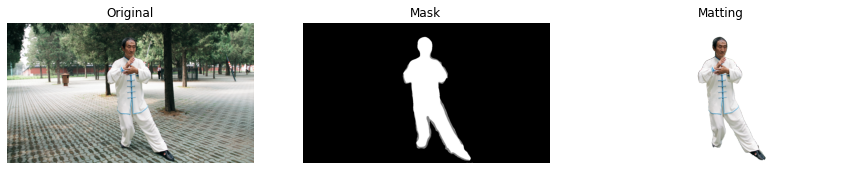

In [11]:
out = gimpml.matting(image, alpha)

fig = plt.figure(figsize=(15, 7))
rows, columns=1,3

fig.add_subplot(rows, columns, 1)
plt.imshow(image)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(alpha)
plt.axis('off')
plt.title("Mask")

fig.add_subplot(rows, columns, 3)
plt.imshow(out)
plt.axis('off')
plt.title("Matting")

cv2.imwrite('output/tmp-matting.png', out[:, :, [2,1,0,3]])  # save as png
torch.cuda.empty_cache()

# Enlightening

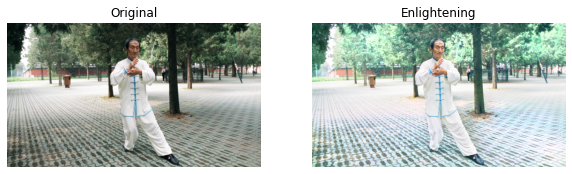

In [12]:
out = gimpml.enlighten(image)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(image)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Enlightening")

cv2.imwrite('output/tmp-enlighten.jpg', out[:, :, ::-1])
torch.cuda.empty_cache()

# Face parsing

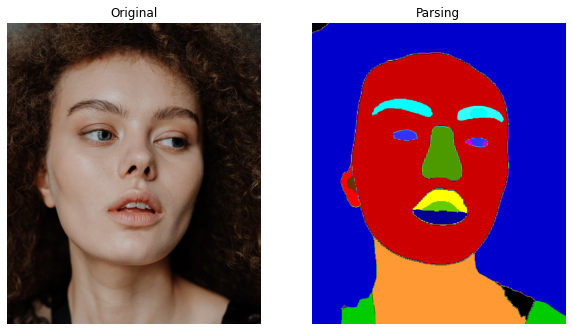

In [13]:
out = gimpml.parseface(face)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(face)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Parsing")

cv2.imwrite('output/tmp-parseface.png', out[:, :, ::-1])
torch.cuda.empty_cache()

# Interpolation

In [14]:
gimpml.interpolateframe(mask1, mask2, 'output/interpolateframes')
torch.cuda.empty_cache()
out = load_images_from_folder('output/interpolateframes')

# fig = plt.figure(figsize=(500, 500))
# rows, columns = len(out)/2,len(out)/2

# for idx, o in enumerate(out):
#     fig.add_subplot(rows, columns, idx+1)
#     plt.imshow(o)
#     plt.axis('off')

# Monodepth

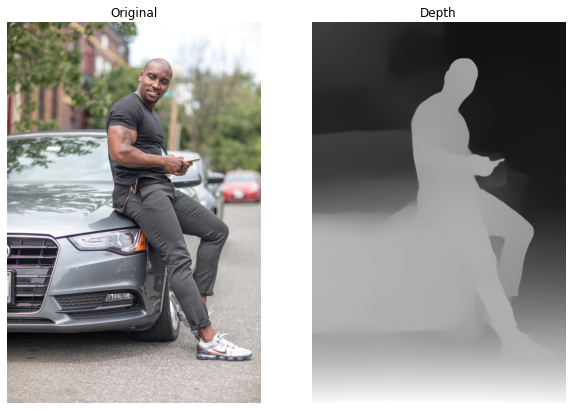

In [15]:
out = gimpml.depth(seg)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(seg)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow((255*out/(out.max()-out.min())).astype(np.uint8))
plt.axis('off')
plt.title("Depth")

cv2.imwrite('output/tmp-depth.png', out.astype("uint16"), [cv2.IMWRITE_PNG_COMPRESSION, 0])
torch.cuda.empty_cache()

# Super-resolution

(759, 640, 3) (3036, 2560, 3)


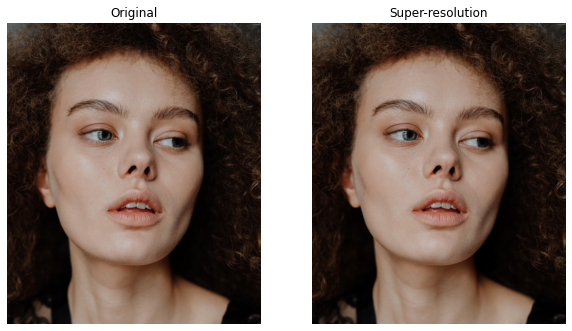

In [16]:
out = gimpml.super(face)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(face)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out.astype(np.uint8))
plt.axis('off')
plt.title("Super-resolution")

cv2.imwrite('output/tmp-super.png', out[:, :, ::-1])
print(face.shape, out.shape)
torch.cuda.empty_cache()

# Semantic Segmentation

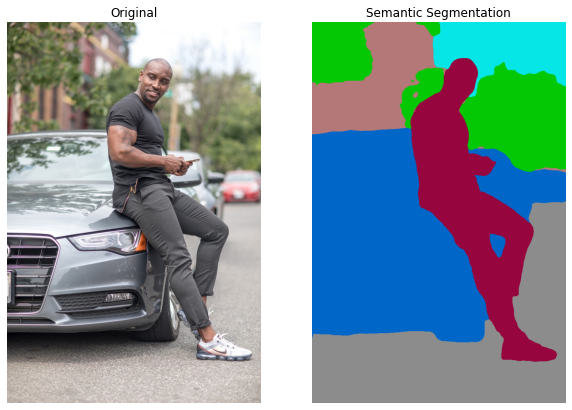

In [17]:
out = gimpml.semseg(seg)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(seg)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Semantic Segmentation")

cv2.imwrite('output/tmp-semseg.png', out[:, :, ::-1])
torch.cuda.empty_cache()

# In-painting/ Edge-connect

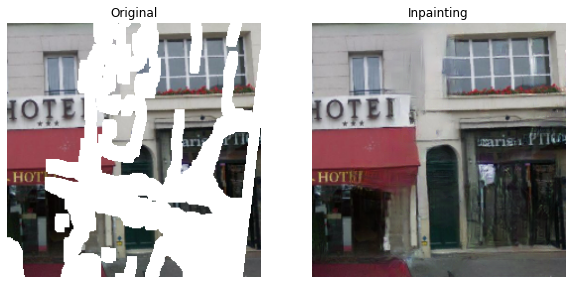

In [18]:
out = gimpml.inpaint(inpaint, inpaint_mask)

fig = plt.figure(figsize=(10, 7))
rows, columns=1,2

fig.add_subplot(rows, columns, 1)
plt.imshow(inpaint)
plt.axis('off')
plt.title("Original")

fig.add_subplot(rows, columns, 2)
plt.imshow(out)
plt.axis('off')
plt.title("Inpainting")

cv2.imwrite('output/tmp-inpaint.png', out[:, :, ::-1])
torch.cuda.empty_cache()